In [14]:
import numpy as np
import cv2
import os
import sys
import matplotlib.pyplot as plt

In [15]:
current_dir = os.getcwd()
parent_dir = os.path.abspath(os.path.join(current_dir, ".."))
sys.path.append(parent_dir)

In [16]:
IMAGES_PATH = "../data"

In [17]:
def get_image_paths_from_dir(directory):
    files = os.listdir(directory)
    image_files = [file for file in files if file.endswith((".jpg", ".jpeg", ".png"))]

    paths = []
    for image_file in image_files:
        image_path = os.path.join(directory, image_file)
        paths.append(image_path)

    return paths

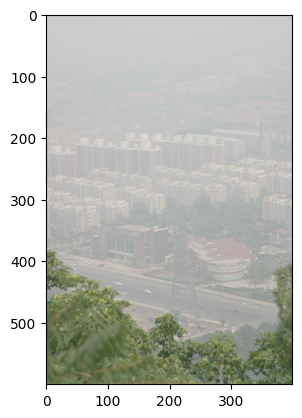

In [18]:
img_hazy = cv2.imread(f"{IMAGES_PATH}/cityscape_input.png")
img_hazy = cv2.cvtColor(img_hazy, cv2.COLOR_BGR2RGB)
plt.imshow(img_hazy)
plt.show()

In [19]:
from dehazing.air_light_estimator import AirLightEstimator

gamma = 0.7
air_light_estimator = AirLightEstimator()

In [20]:
from dehazing.dehazer import Dehazer

dehazer = Dehazer(n_points=1000, gamma=gamma)

In [21]:
# fig, axs = plt.subplots(1, 3, figsize=(18, 10))

# axs[0].imshow(img_hazy)
# axs[0].set_title("Original")
# axs[0].axis("off")

# axs[1].imshow(img_dehazed)
# axs[1].set_title("Dehazed")
# axs[1].axis("off")

# axs[2].imshow(transmission_map, cmap="jet")
# axs[2].set_title("Transmission Map")
# axs[2].axis("off")

# plt.tight_layout()
# plt.show()

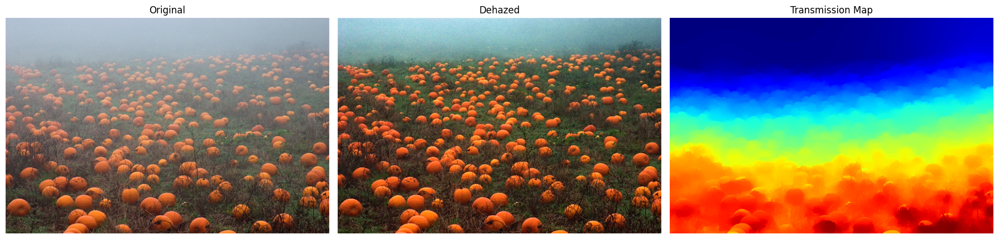

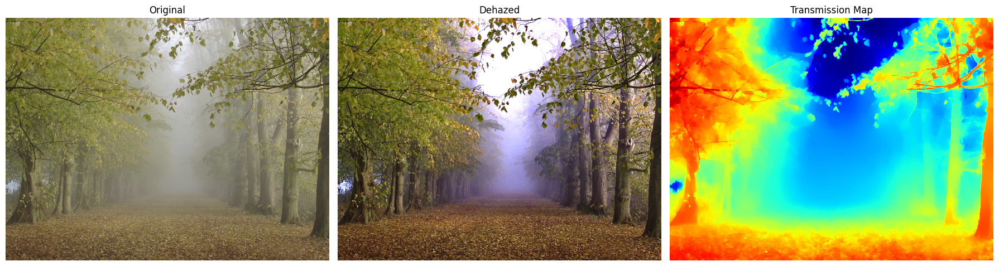

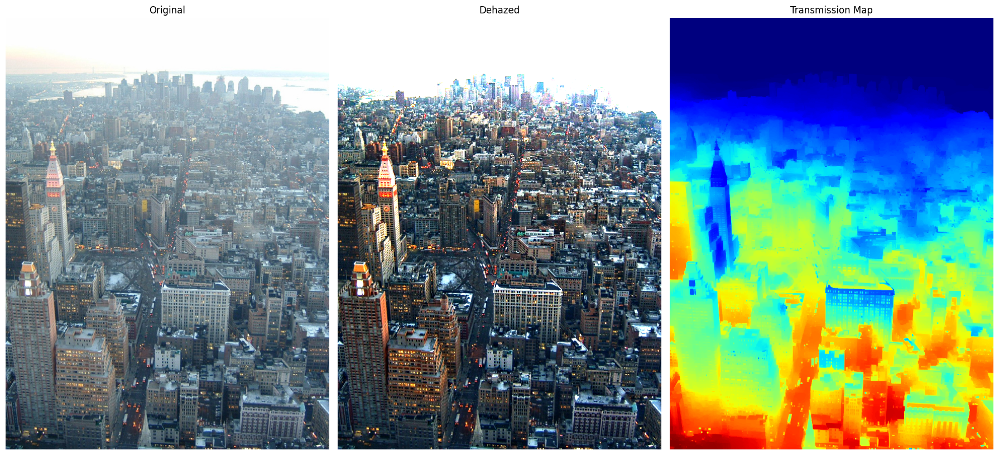

/Users/miltonlopez/repos/dehazing/ndeh_env/lib/python3.11/site-packages/sklearn/base.py:1474: ConvergenceWarning: Number of distinct clusters (256) found smaller than n_clusters (1000). Possibly due to duplicate points in X.
  return fit_method(estimator, *args, **kwargs)


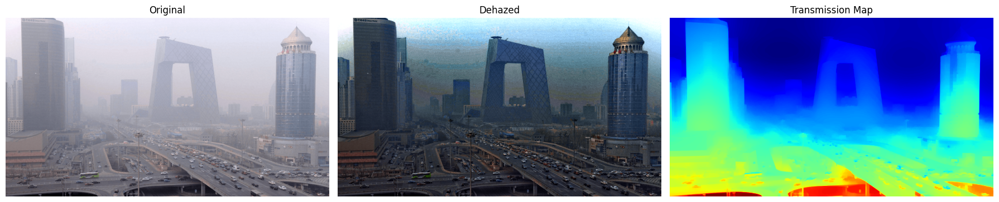

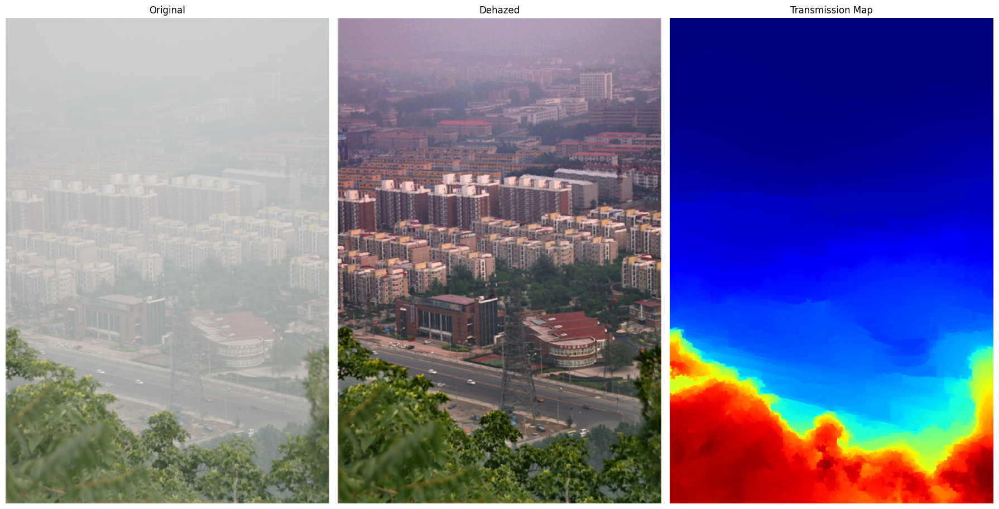

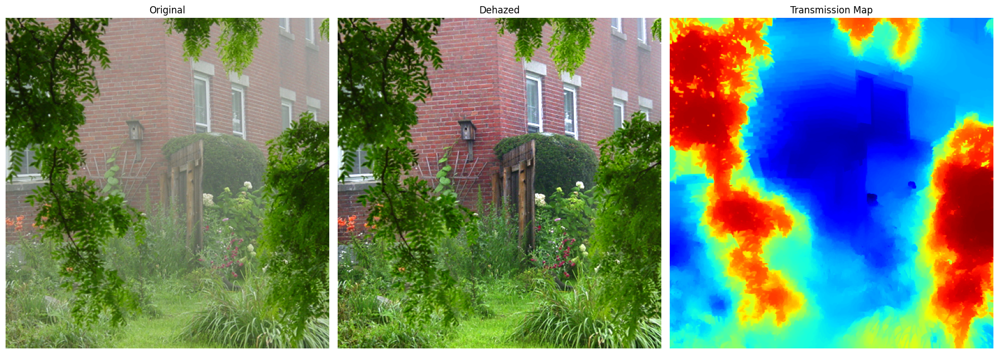

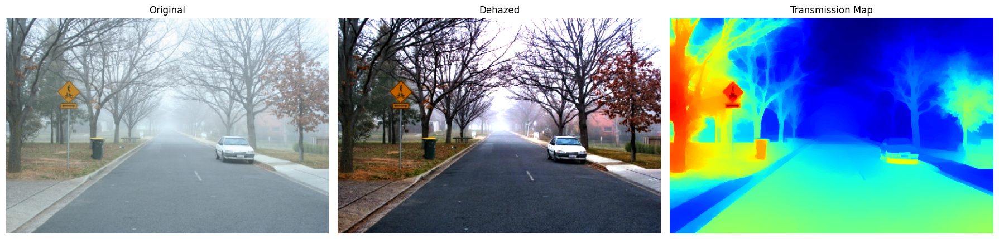

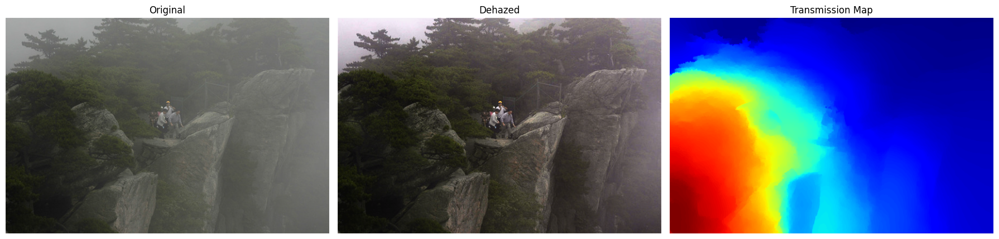

...

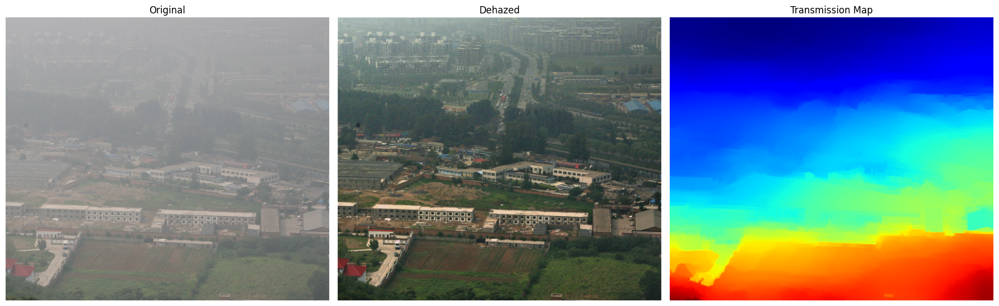

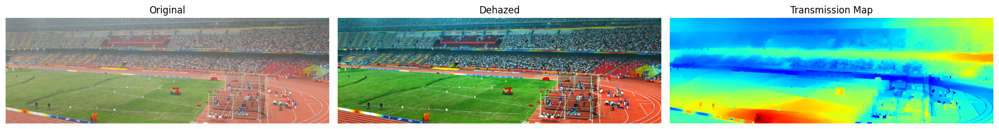

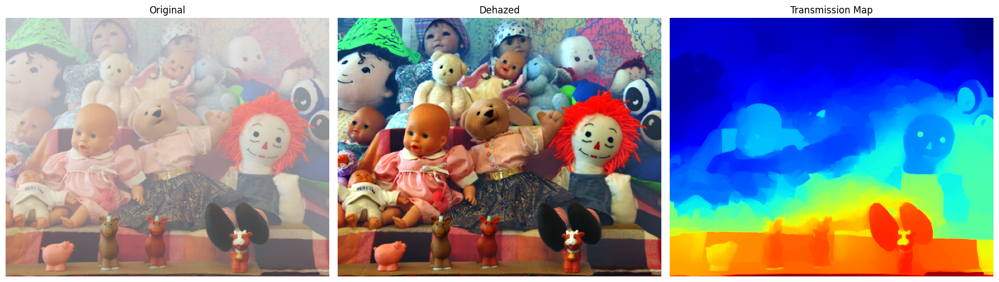

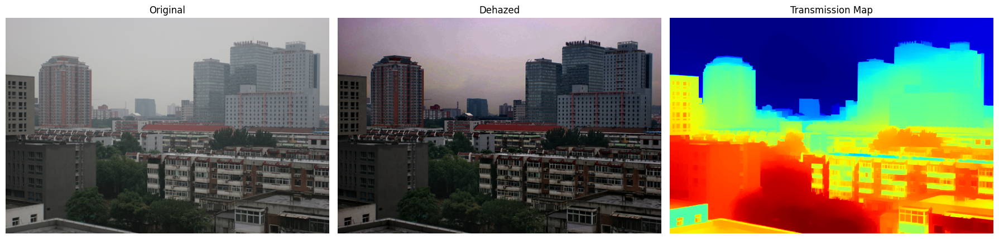

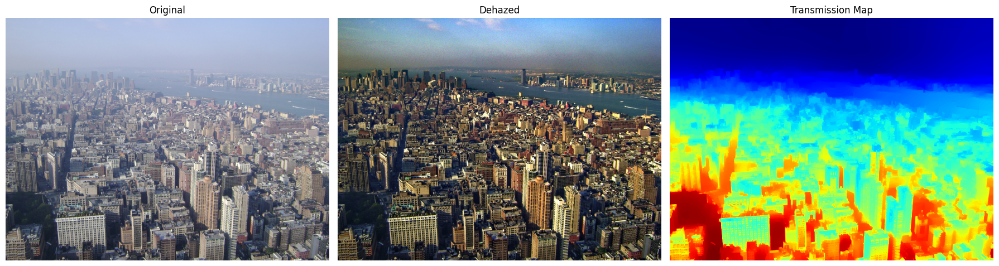

In [22]:
for image_path in get_image_paths_from_dir(IMAGES_PATH):
    img = cv2.imread(image_path)
    img_rgb = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

    img_gamma_corrected = np.power(img_rgb / 255.0, gamma)
    air_light = air_light_estimator.estimate_airlight(img_gamma_corrected)

    img_dehazed, transmission_map = dehazer.non_local_dehazing(img_rgb, air_light)

    fig, (ax1, ax2, ax3) = plt.subplots(1, 3, figsize=(18, 10))

    ax1.imshow(img_rgb)
    ax1.set_title("Original")
    ax1.axis("off")

    ax2.imshow(img_dehazed)
    ax2.set_title("Dehazed")
    ax2.axis("off")

    ax3.imshow(transmission_map, cmap="jet")
    ax3.set_title("Transmission Map")
    ax3.axis("off")

    plt.tight_layout()
    plt.show()